<a href="https://colab.research.google.com/github/FangmingXie/collab-workshop-st/blob/main/Collab_ST_Day2_v2_fullsolution.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Typical analyses in spatial transcriptomics
### Spatial transcriptomics coding exercise (Day 2) -- UCLA Collaboratory
Fangming Xie

November 2022

Dataset:
Vizgen Data Release V1.0. May 2021



In [ ]:
# Install and import packages
!pip install umap-learn
from umap import UMAP # this is installed by us

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Install and import packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import time

# set plot style
%matplotlib inline
%config InlineBackend.figure_format='retina'
sns.set_context('talk')

np.set_printoptions(precision=2)
np.set_printoptions(suppress=True)

In [ ]:
# functions (the teacher wrote for you to use later)
def rot2d(x, y, theta, unit='degree'):
  """ rotate data points defined by `x` and `y` by `theta` degree
  """
  a = np.vstack([x,y]).T
  if unit == 'degree':
    theta = theta*np.pi/180 # convert to radian

  R = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
  ar = a.dot(R.T)
  return ar[:,0], ar[:,1]

def st_scatter(x, y, gexp=None, vmax_p=98, title='', s=1):
  """customized scatter plot -- yesterday's progress
  """

  fig, ax = plt.subplots(figsize=(10,8))
  if gexp is not None:
    vmax = np.percentile(gexp, vmax_p)
    g = ax.scatter(x, y, c=gexp, s=s, edgecolor='none', vmax=vmax)
    fig.colorbar(g, label='log10(1+count)', shrink=0.3)
  else:
    g = ax.scatter(x, y, s=s, edgecolor='none')

  ax.set_title(title)
  ax.set_aspect('equal')

  return 

In [ ]:
np.random.seed(0) # for reproducibility

## Load data

In [ ]:
f = '/content/vizgen_mouse_brain_S2R2.csv.gz'
data = pd.read_csv(f, index_col=0)
data

,x,y,Oxgr1,Htr1a,Htr1b,Htr1d,Htr1f,Htr2a,Htr2b,Htr2c,...,Pdgfrb,Ptk7,Ret,Ror1,Ror2,Ros1,Ryk,Tek,Tie1,Tyro3
0,594.918018,5628.150243,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,4.0,1.0,0.0
1,576.450018,5762.286246,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.0,2.0,0.0,1.0,4.0,0.0,3.0,0.0,0.0,0.0
2,564.462017,5721.624245,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,538.164017,5605.475642,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,610.362018,5652.936244,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84167,9235.566329,3349.566107,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0
84168,9225.738329,3261.654105,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.0,3.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0
84169,9230.976329,3287.358106,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.0,1.0,0.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0
84170,9236.754329,3364.956108,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


## Check cell locations, rotation, and visualization of gene expression.

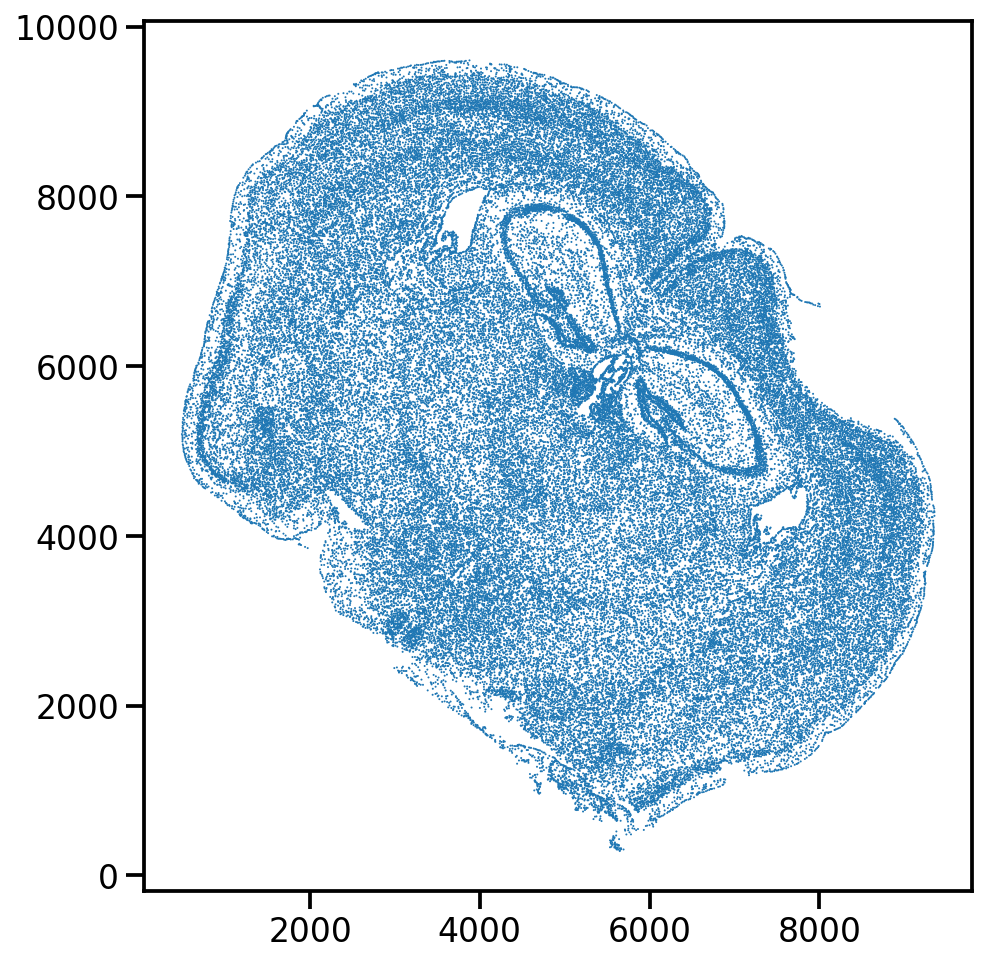

In [ ]:
x = data['x'].values
y = data['y'].values
st_scatter(x, y)

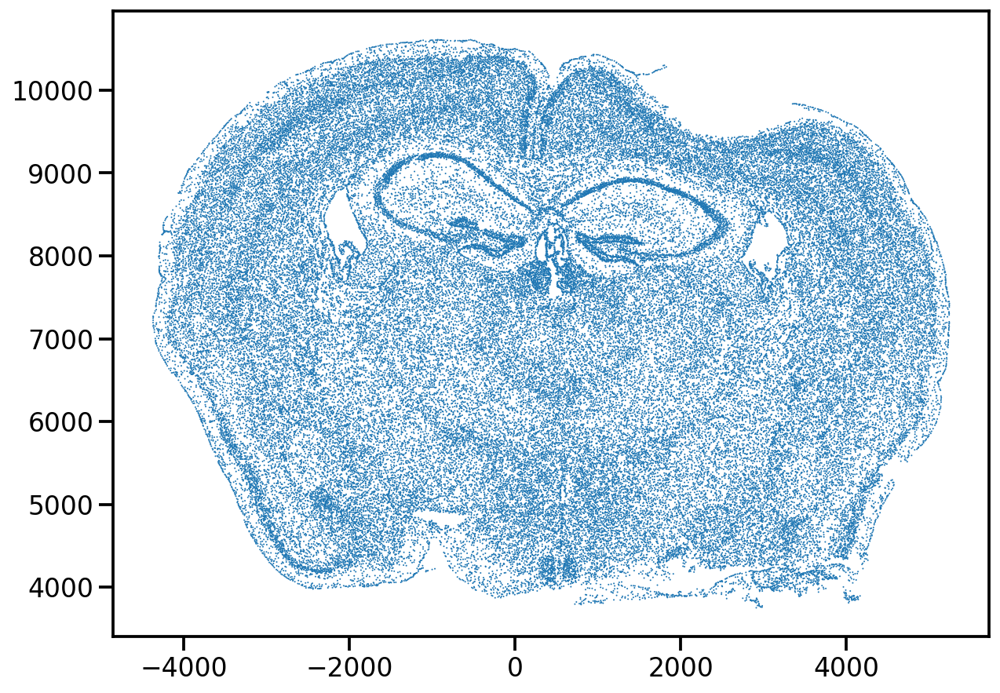

In [ ]:
theta = 40
xr, yr = rot2d(x, y, theta)
st_scatter(xr, yr)

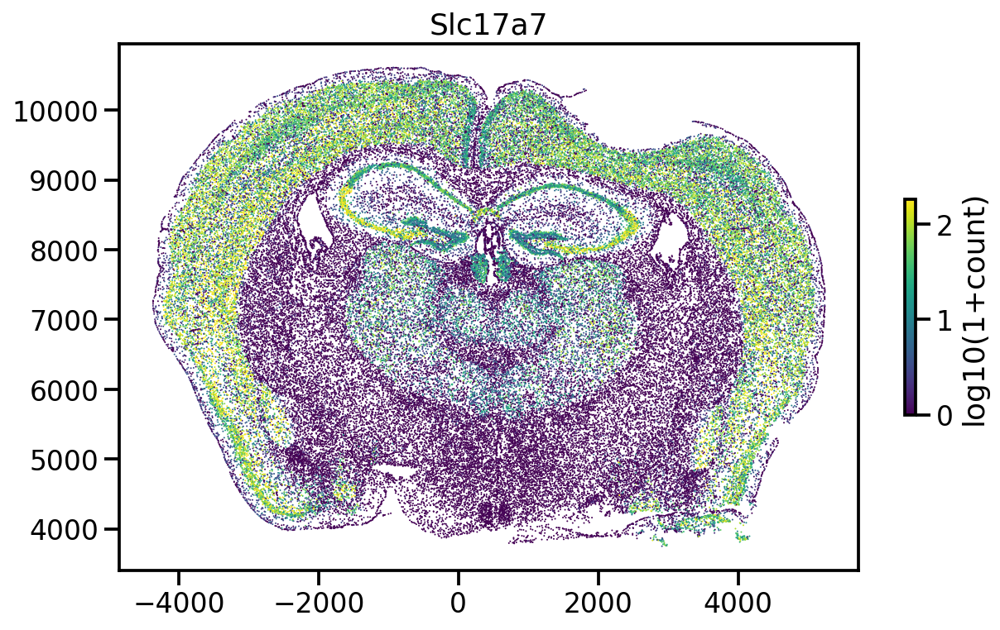

In [ ]:
gene_name = 'Slc17a7'
gexp = np.log10(1+data[gene_name])

st_scatter(xr, yr, gexp, title=gene_name)

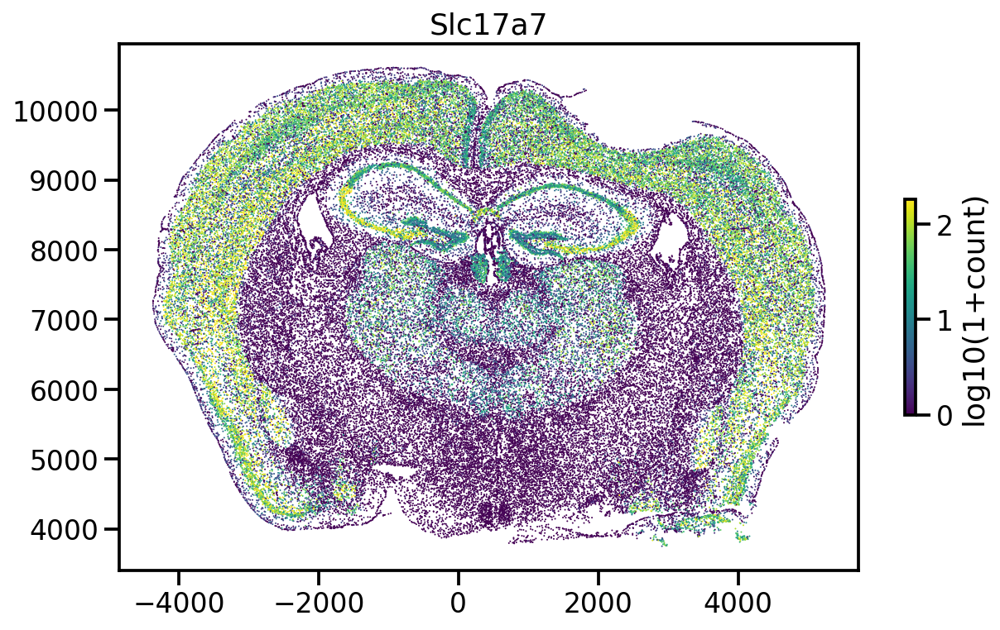

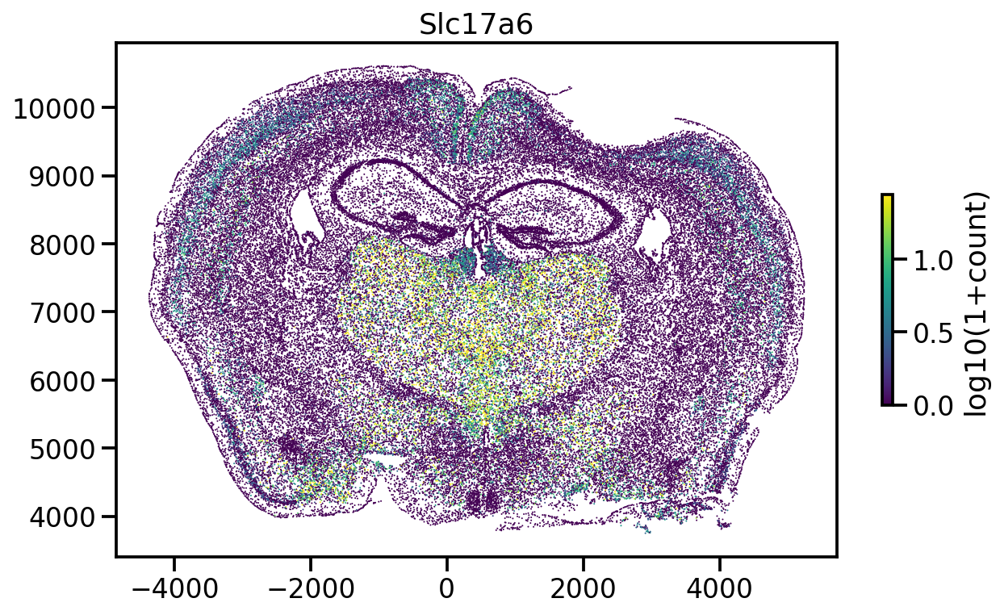

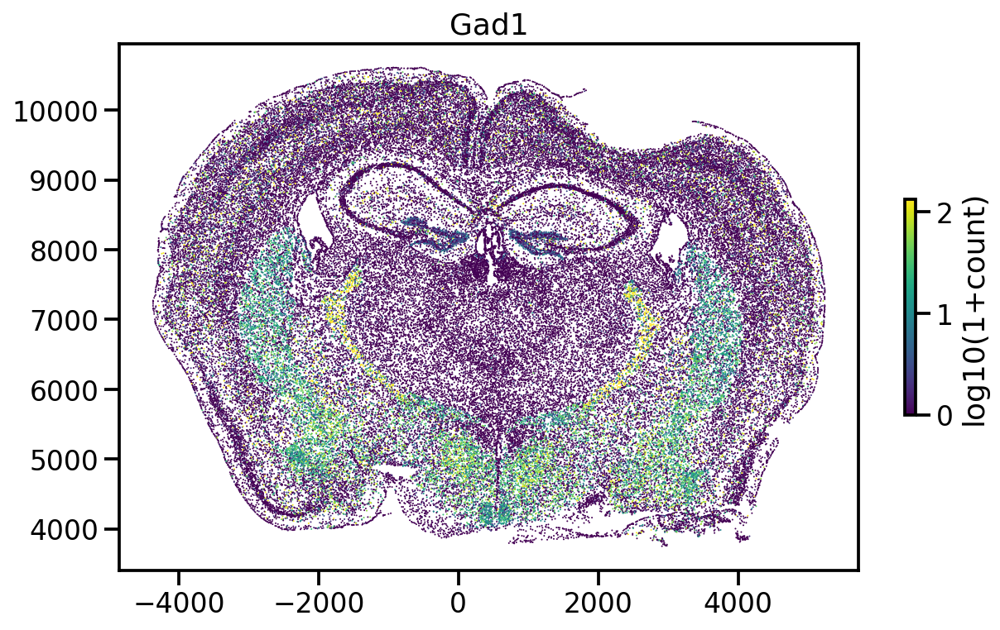

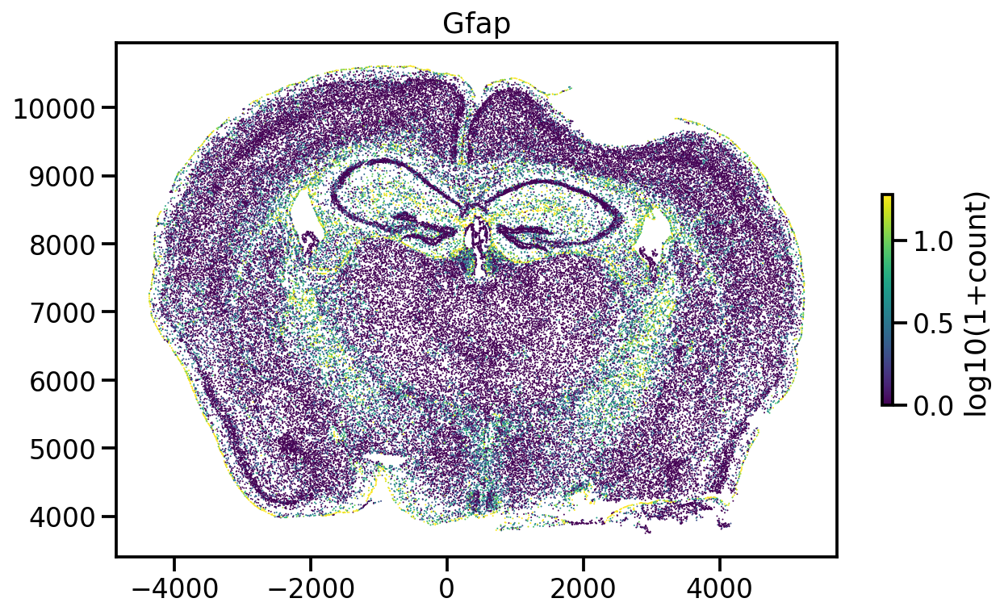

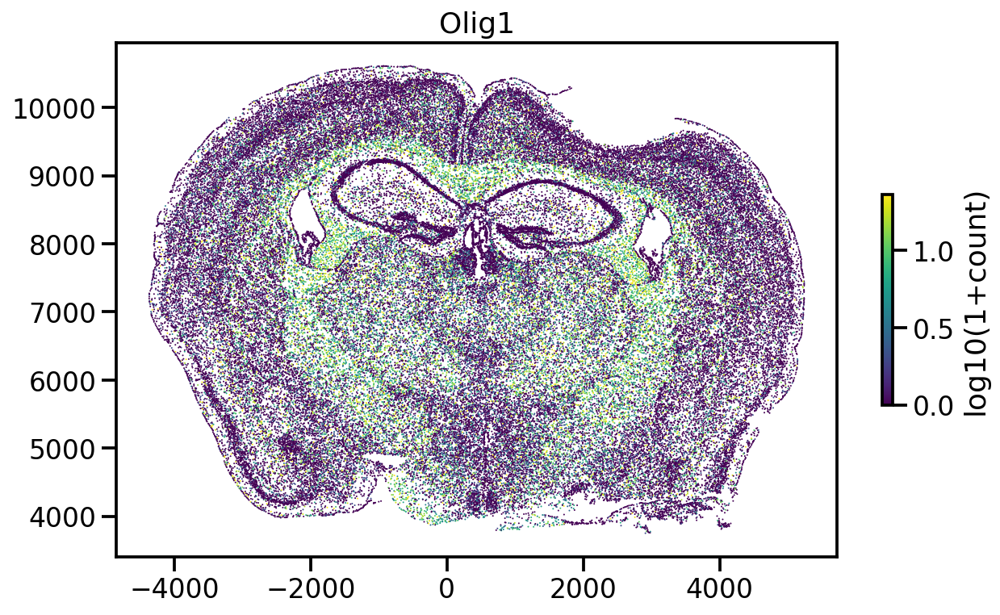

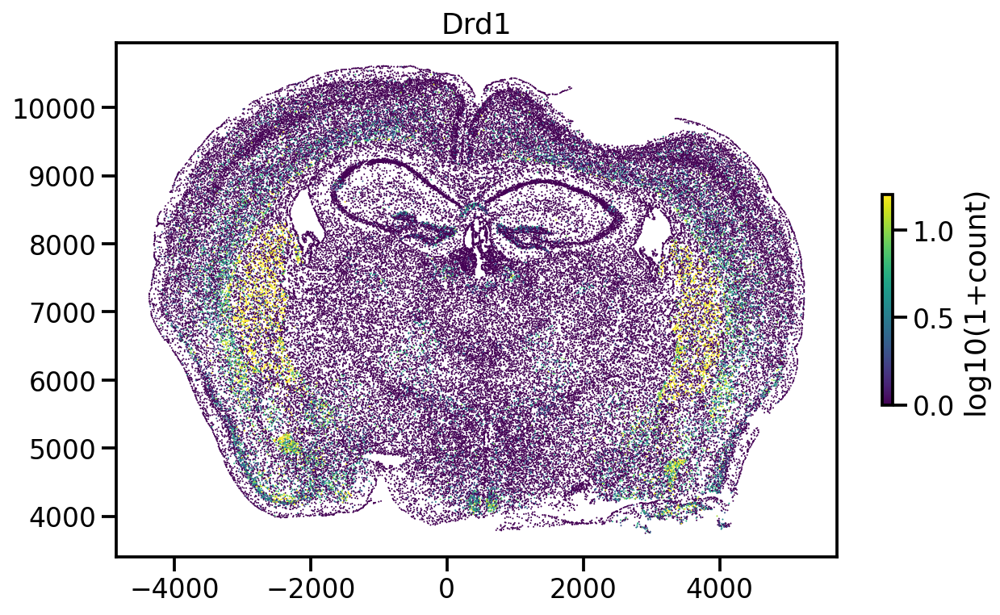

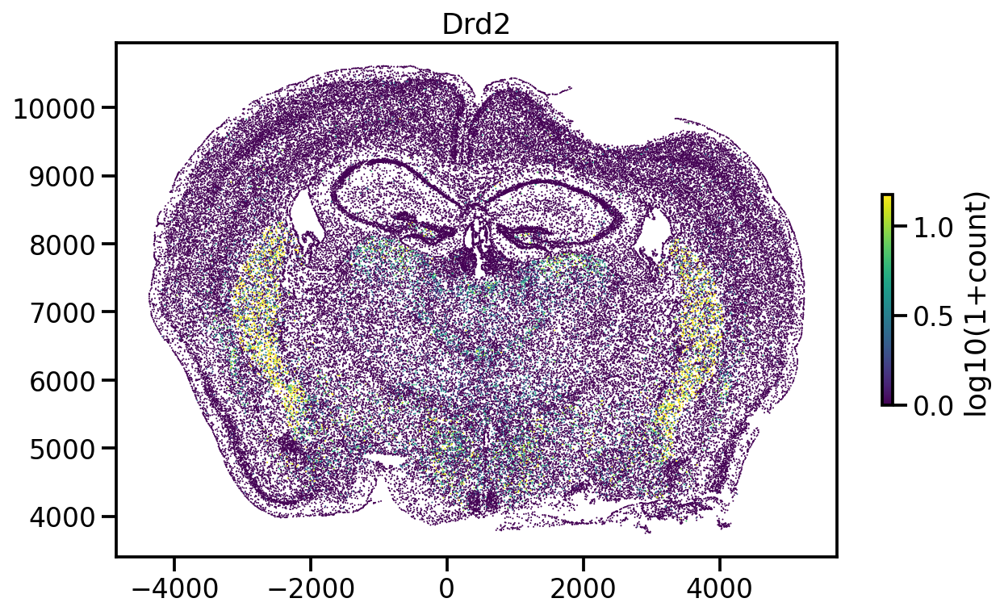

In [ ]:
gene_names = [
  'Slc17a7',
  'Slc17a6',
  'Gad1',
  'Gfap',
  'Olig1',
  'Drd1',
  'Drd2',
]
for gene_name in gene_names:
  gexp = np.log10(1+data[gene_name])
  
  st_scatter(xr, yr, gexp, title=gene_name)

## Dimensionality reduction using PCA

In [ ]:
ftrs = data.iloc[:,2:]
ftrs

,Oxgr1,Htr1a,Htr1b,Htr1d,Htr1f,Htr2a,Htr2b,Htr2c,Htr4,Htr5a,...,Pdgfrb,Ptk7,Ret,Ror1,Ror2,Ros1,Ryk,Tek,Tie1,Tyro3
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,4.0,1.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,4.0,2.0,0.0,1.0,4.0,0.0,3.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0
84168,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,5.0,3.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0
84169,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.0,1.0,0.0,0.0,1.0,0.0,3.0,0.0,0.0,0.0
84170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [ ]:
ti = time.time()
num_pc = 20
print("PCA...", end='')
pca_obj = PCA(n_components=num_pc)
pcs = pca_obj.fit_transform(ftrs)
print(f"done in {time.time()-ti:.2f}s")
print(pcs.shape)

PCA...done in 4.57s
(84172, 20)


Text(0, 0.5, 'Variance explained')

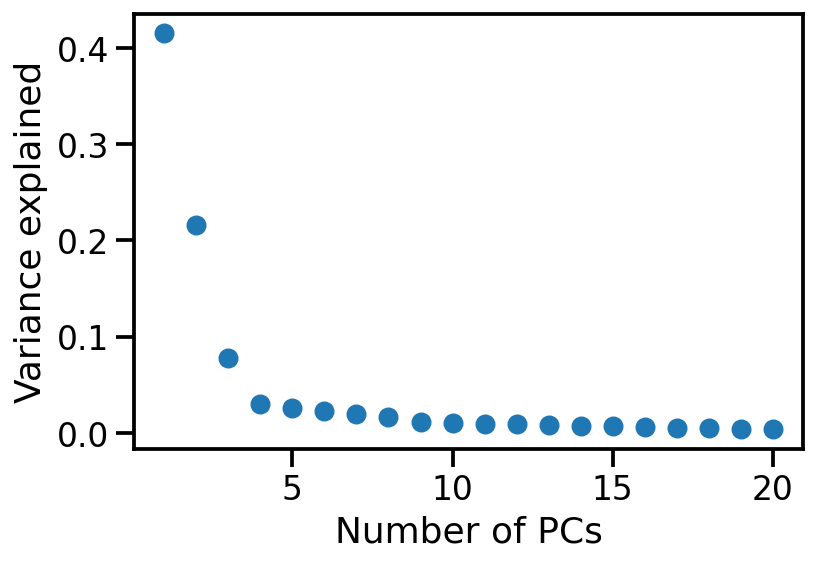

In [ ]:
plt.plot(1+np.arange(num_pc), pca_obj.explained_variance_ratio_, 'o')
plt.xlabel('Number of PCs')
plt.ylabel('Variance explained')

Text(0, 0.5, 'Cumulative variance explained')

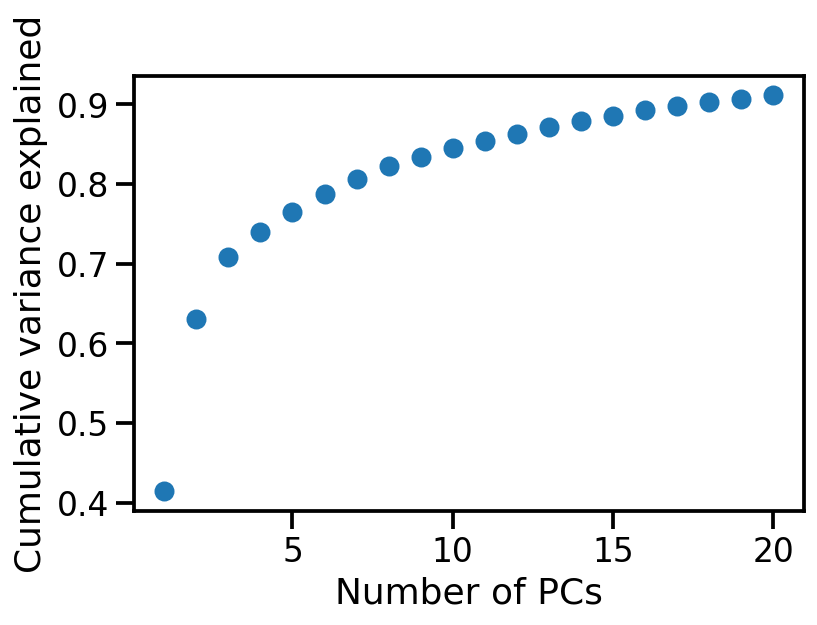

In [ ]:
plt.plot(
    1+np.arange(num_pc), 
    np.cumsum(pca_obj.explained_variance_ratio_), 'o')
plt.xlabel('Number of PCs')
plt.ylabel('Cumulative variance explained')

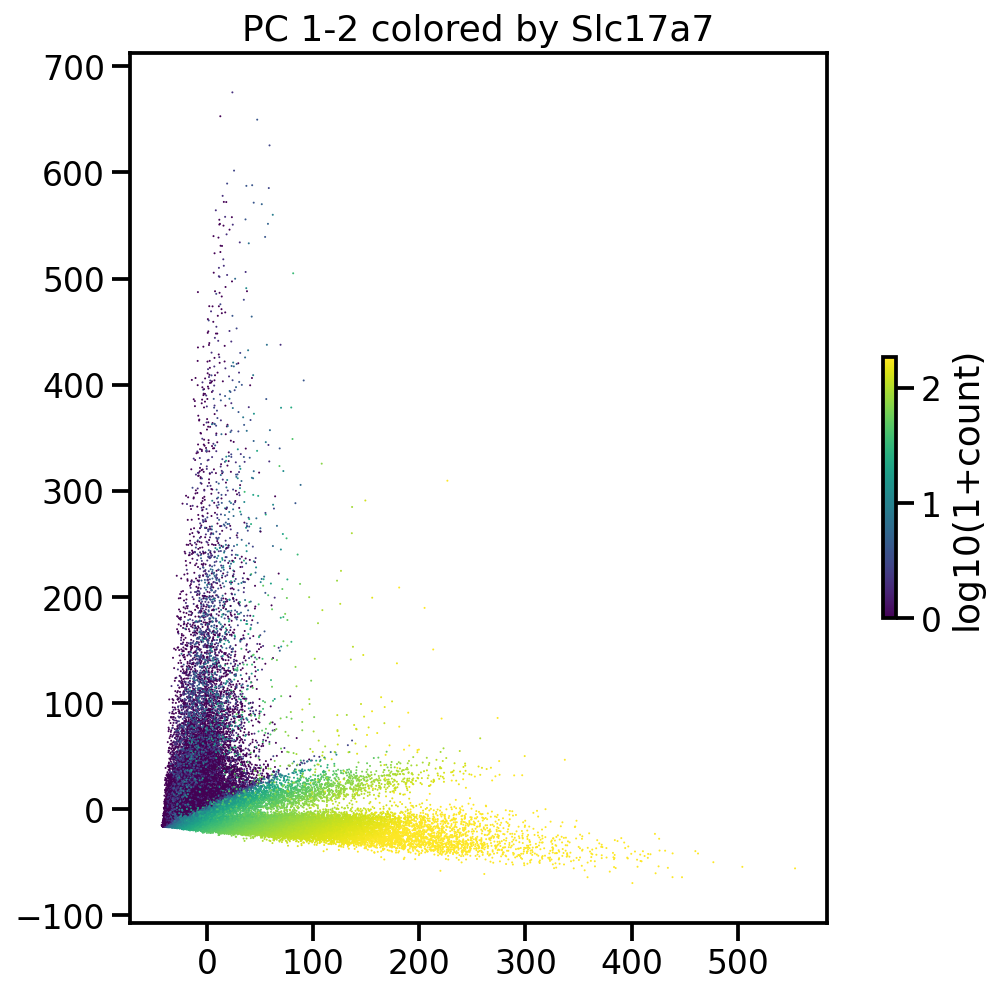

In [ ]:
pc1 = pcs[:,0]
pc2 = pcs[:,1]
gexp = np.log10(1+ftrs['Slc17a7'])
st_scatter(pc1, pc2, gexp, title="PC 1-2 colored by Slc17a7")

## Dimensionality reduction using UMAP

In [ ]:
# takes ~3 min 
ti = time.time()
print("UMAP...", end='')
ucs = UMAP(n_components=2).fit_transform(pcs)
print(f"done in {time.time()-ti:.2f}s")
print(ucs.shape)

UMAP...done in 166.20s
(84172, 2)


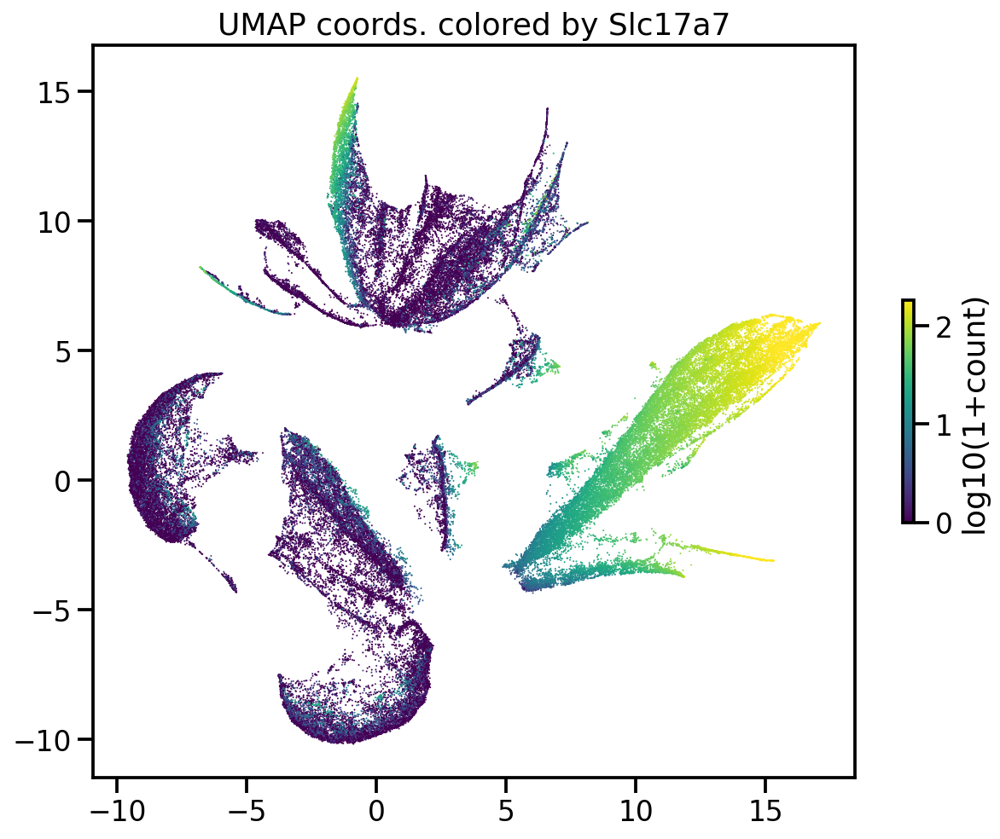

In [ ]:
uc1 = ucs[:,0]
uc2 = ucs[:,1]
gexp = np.log10(1+ftrs['Slc17a7'])
st_scatter(uc1, uc2, gexp, title="UMAP coords. colored by Slc17a7")

In [ ]:
## 

## A toy model comparing PCA and UMAP

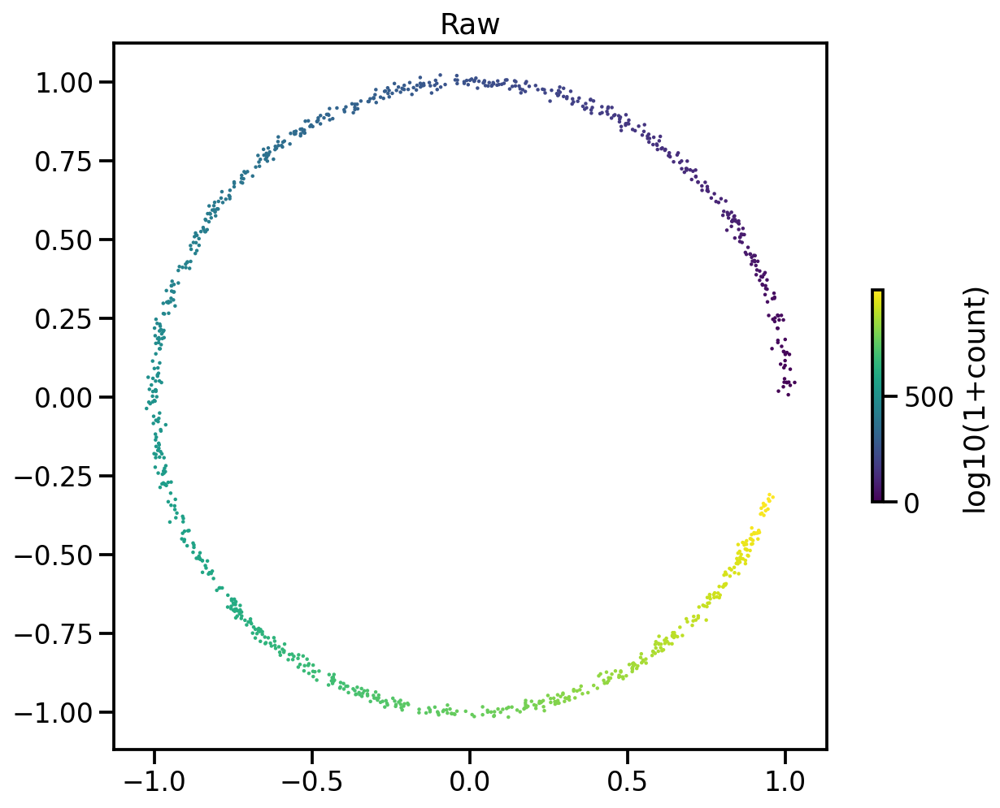

In [ ]:
n = 1000
noise = 0.01

thetas = 1.9*np.pi*np.sort(np.random.rand(n))
rs = 1+noise*np.random.randn(n)
simu_x = rs*np.cos(thetas)
simu_y = rs*np.sin(thetas)

st_scatter(simu_x, simu_y, gexp=np.arange(n), s=5, title='Raw', vmax_p=100)

In [ ]:
data_toy = np.vstack([simu_x, simu_y]).T

pcs_toy = PCA(n_components=2).fit_transform(data_toy)
ucs_toy = UMAP(n_components=2).fit_transform(data_toy)
ucs_toy1dim = UMAP(n_components=1).fit_transform(data_toy)

print(data_toy.shape, pcs_toy.shape, ucs_toy.shape, ucs_toy1dim.shape)

(1000, 2) (1000, 2) (1000, 2) (1000, 1)


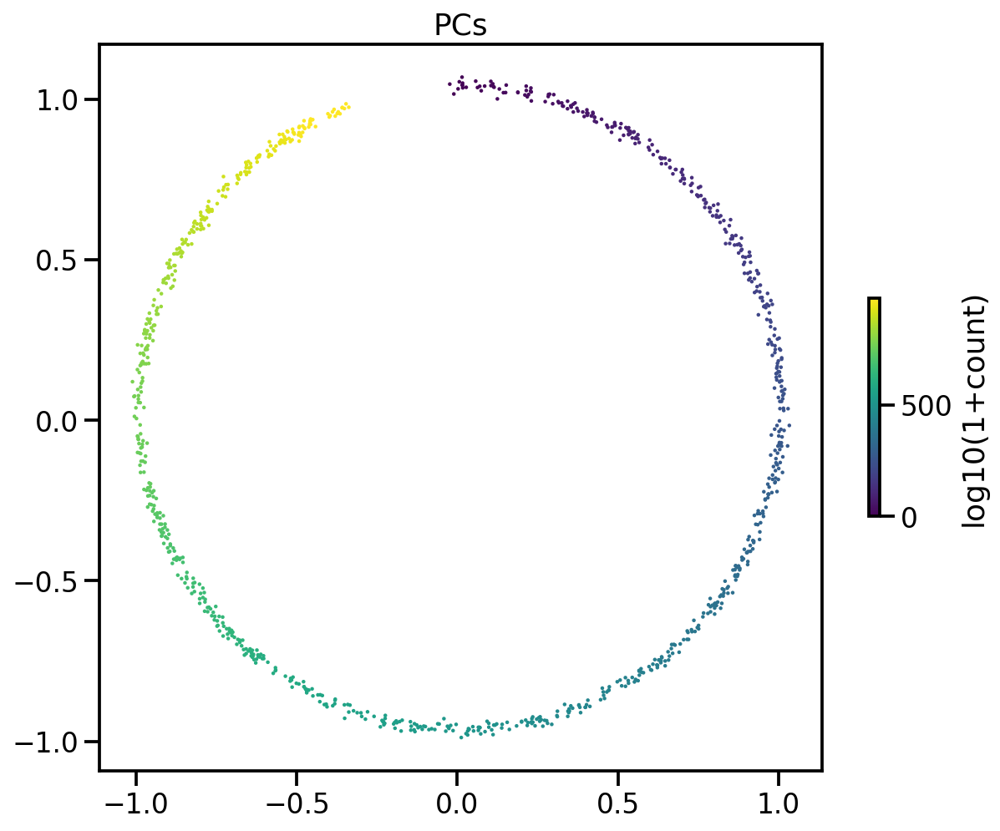

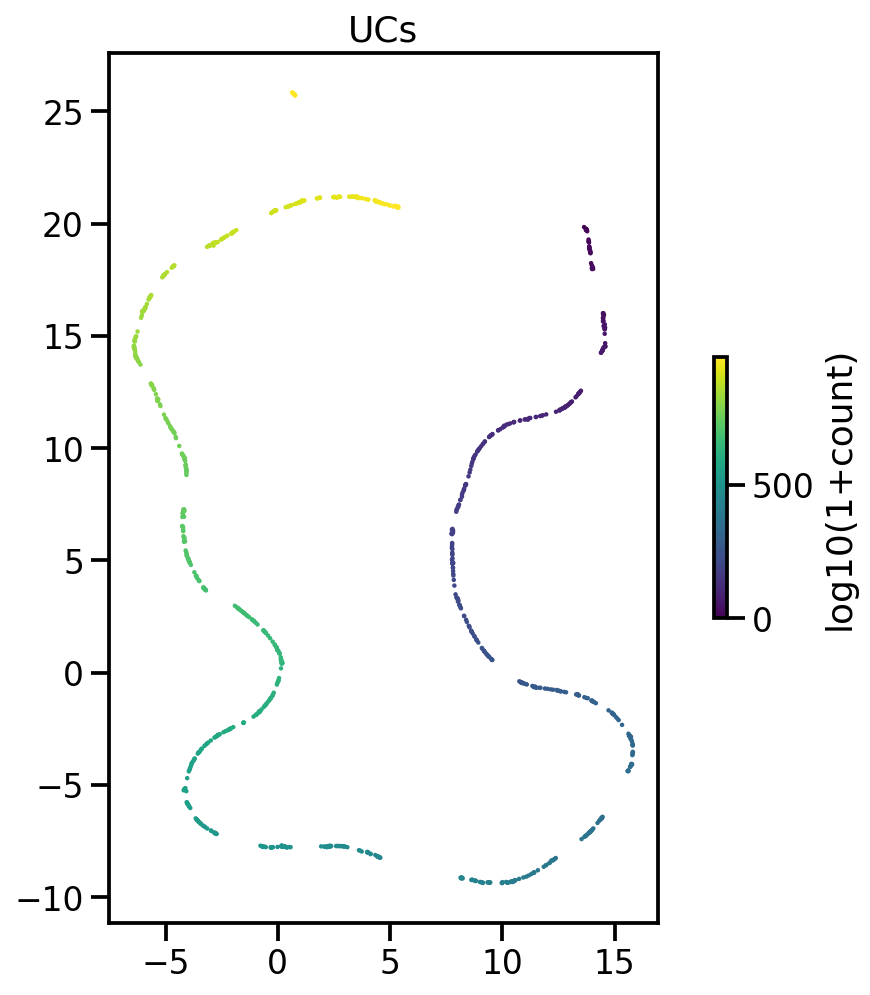

In [ ]:
st_scatter(pcs_toy[:,0], pcs_toy[:,1], gexp=np.arange(n), title="PCs", s=5)
st_scatter(ucs_toy[:,0], ucs_toy[:,1], gexp=np.arange(n), title="UCs", s=5)

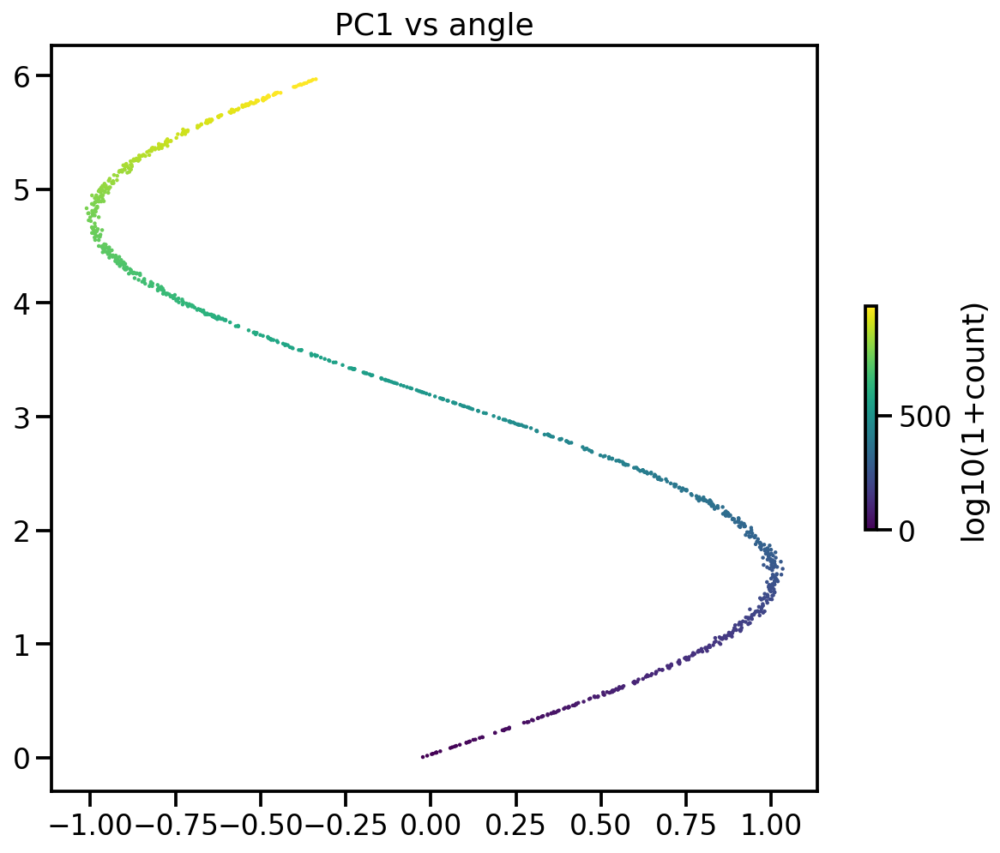

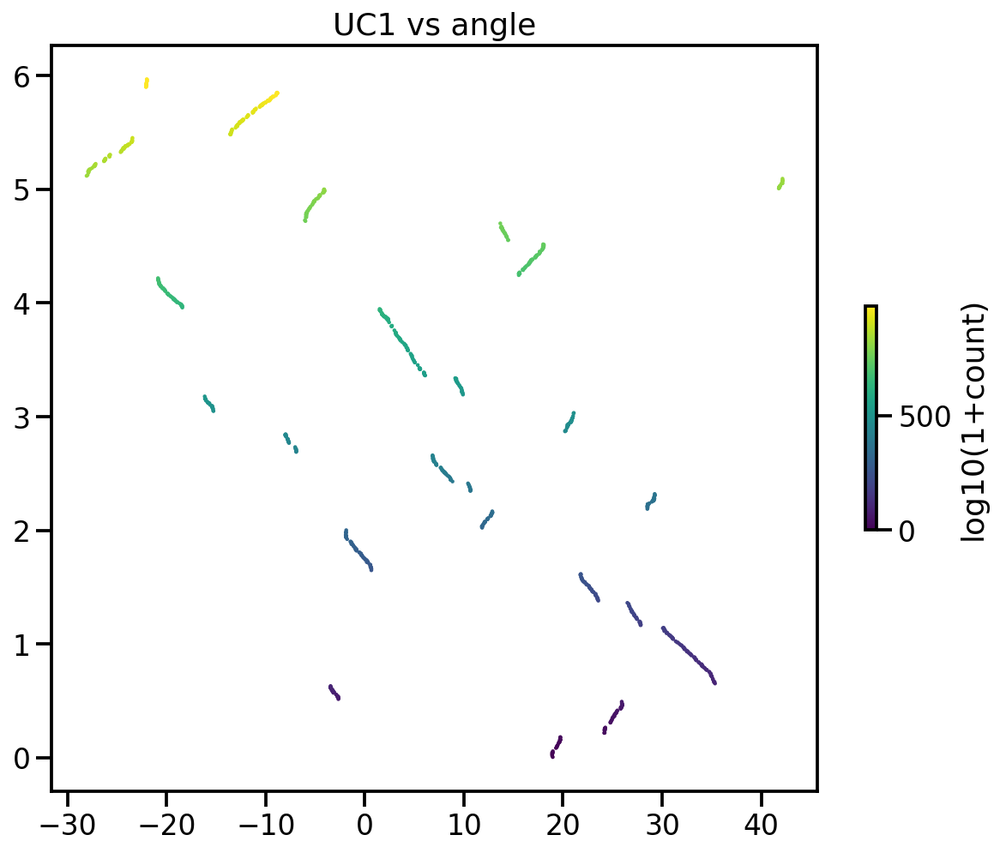

In [ ]:
st_scatter(pcs_toy[:,0], thetas, gexp=np.arange(n), title="PC1 vs angle", s=5)
plt.gca().set_aspect('auto')
st_scatter(ucs_toy1dim[:,0], thetas, gexp=np.arange(n), title="UC1 vs angle", s=5)
plt.gca().set_aspect('auto')

## A side (but quite important) note on normalization:
- neither PCA nor UMAP are magic, in the sense that they do not separate technical noise from biological signals.
- for this reason, we often need to do normalization on raw data to remove known technical artifacts.
- In single-cell transcriptomics, a rule of thumb is to normalize raw counts by cell size (or cell library size) and do log transformation. (why?)

In [ ]:
# normalization by size (total counts or volume)
cov = ftrs.sum(axis=1)
medcov = np.median(cov)

# normalization by log(1+x) (squashes different orders of magnitude together)
ftrs_normed = ftrs.divide(cov/medcov, axis=0)
ftrs_normed = np.log10(1+ftrs_normed)
ftrs_normed

,Oxgr1,Htr1a,Htr1b,Htr1d,Htr1f,Htr2a,Htr2b,Htr2c,Htr4,Htr5a,...,Pdgfrb,Ptk7,Ret,Ror1,Ror2,Ros1,Ryk,Tek,Tie1,Tyro3
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.436543,0.89925,0.436543,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.578357,0.379082,0.0,0.229652,0.578357,0.0,0.490050,0.00000,0.000000,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.416281,0.000000,0.0,0.000000,0.000000,0.0,0.416281,0.00000,0.000000,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.00000,0.000000,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.577453,0.000000,0.0,0.000000,0.000000,0.0,0.577453,0.00000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84167,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.477121,0.000000,0.0,0.000000,0.000000,0.0,0.477121,0.00000,0.000000,0.0
84168,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.873535,0.688794,0.0,0.000000,0.555031,0.0,0.555031,0.00000,0.000000,0.0
84169,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.610128,0.306425,0.0,0.000000,0.306425,0.0,0.610128,0.00000,0.000000,0.0
84170,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.551755,0.358173,0.0,0.000000,0.000000,0.0,0.358173,0.00000,0.000000,0.0


In [ ]:
%%time
# UMAP takes ~2.5 min
ti = time.time()
print("PCA...", end='')
pcs_normed = PCA(n_components=20).fit_transform(ftrs_normed)
print(f"done in {time.time()-ti:.2f}s")
print(pcs_normed.shape)

print("UMAP...", end='')
ucs_normed = UMAP(n_components=2).fit_transform(pcs_normed)
print(f"done in {time.time()-ti:.2f}s")
print(ucs_normed.shape)

PCA...done in 4.23s
(84172, 20)
UMAP...done in 114.64s
(84172, 2)
CPU times: user 3min 20s, sys: 6.5 s, total: 3min 27s
Wall time: 1min 54s


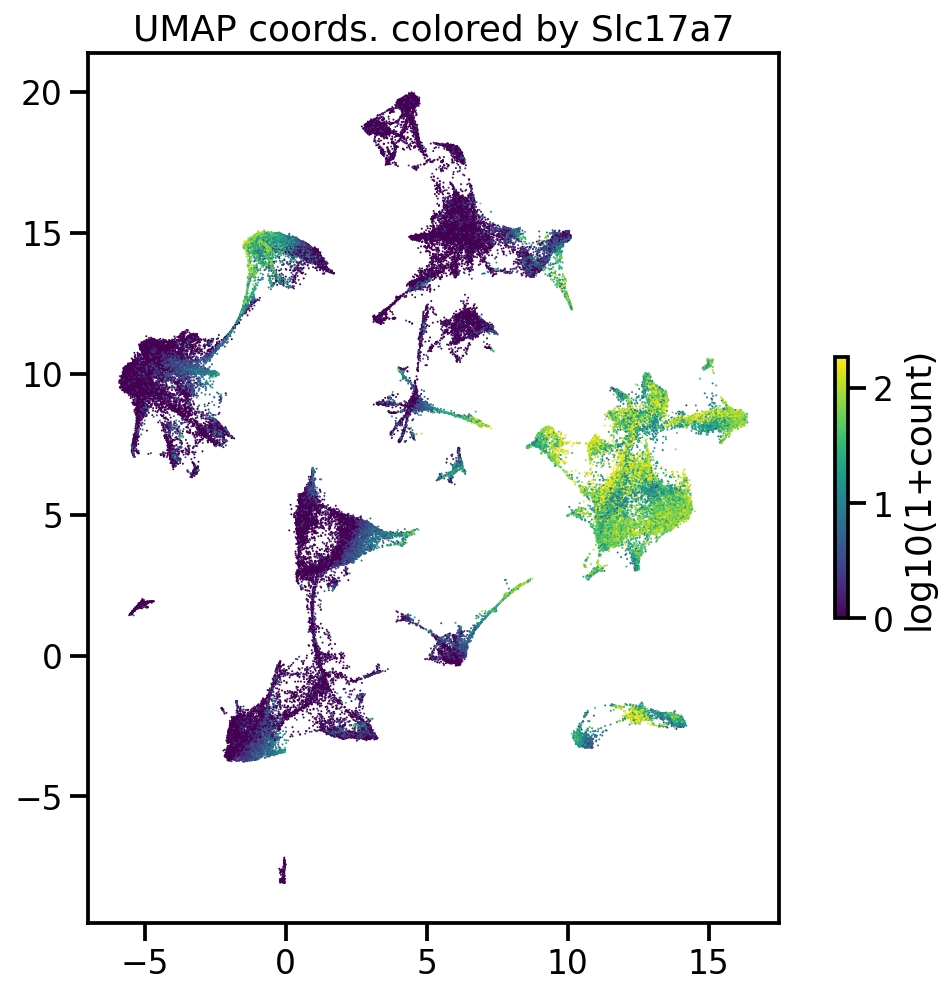

In [ ]:
uc1 = ucs_normed[:,0]
uc2 = ucs_normed[:,1]
gexp = np.log10(1+ftrs['Slc17a7'])
st_scatter(uc1, uc2, gexp, title="UMAP coords. colored by Slc17a7")


## visualize individual genes in XY and UMAP 

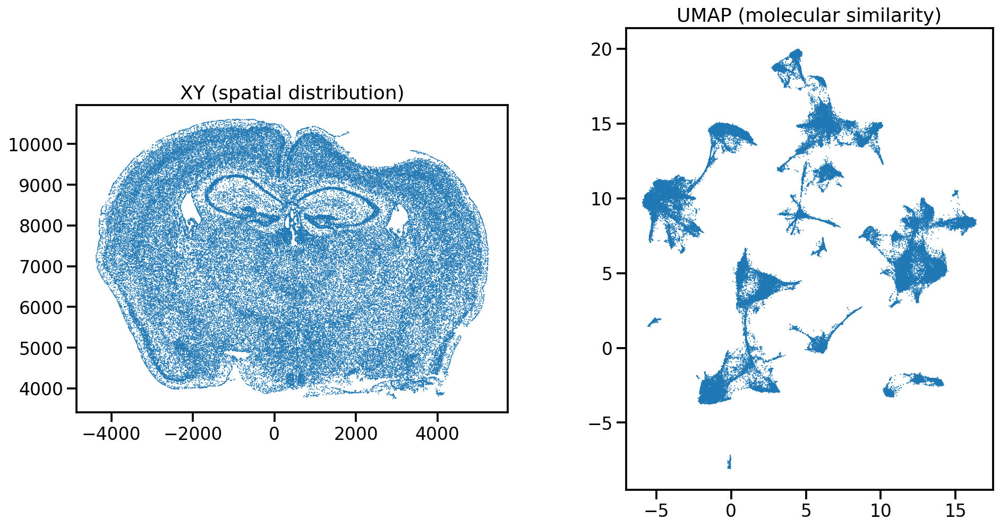

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(8*2,8))
ax = axs[0]
ax.scatter(xr, yr, s=1, edgecolor='none')
ax.set_title('XY (spatial distribution)')
ax.set_aspect('equal')

ax = axs[1]
ax.scatter(uc1, uc2, s=1, edgecolor='none')
ax.set_title('UMAP (molecular similarity)')
ax.set_aspect('equal')

In [ ]:
def st_scatter_xy_umap(x, y, ux, uy, ftrs_normed, gene=None):
  """plot XY and UMAP side by side colored by gene
  """
  if gene is not None:
      gval = ftrs_normed[gene]

  fig, axs = plt.subplots(1, 2, figsize=(8*2,8))
  fig.suptitle(gene)
  
  ax = axs[0]
  g = ax.scatter(xr, yr, c=gval, s=1, edgecolor='none')
  ax.set_title('XY (spatial distribution)')
  ax.set_aspect('equal')
  
  ax = axs[1]
  ax.scatter(ux, uy, c=gval, s=1, edgecolor='none')
  ax.set_title('UMAP (molecular similarity)')
  ax.set_aspect('equal')
  fig.colorbar(g, ax=ax, shrink=0.3, label='normed counts\n(by size and log10(x+1))')

  return 

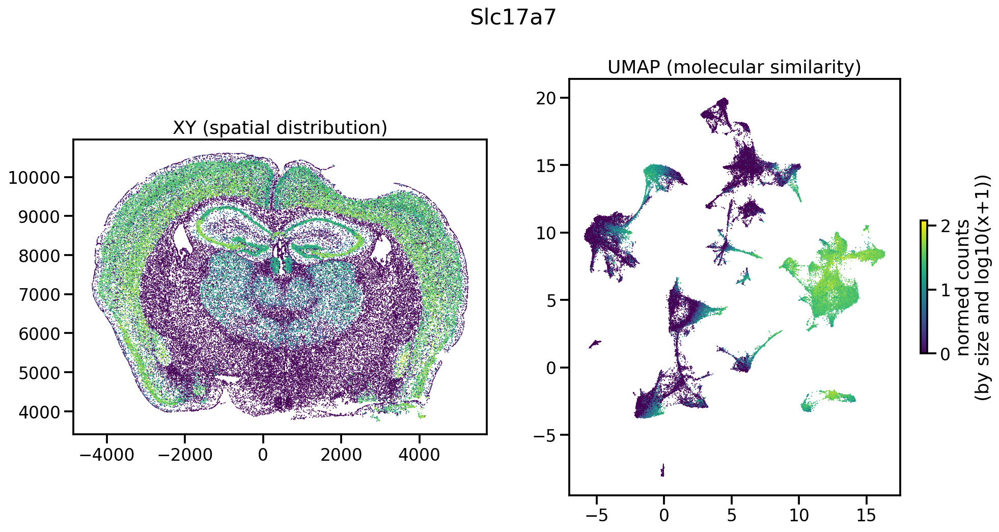

In [ ]:
st_scatter_xy_umap(xr, yr, uc1, uc2, ftrs_normed, 'Slc17a7')

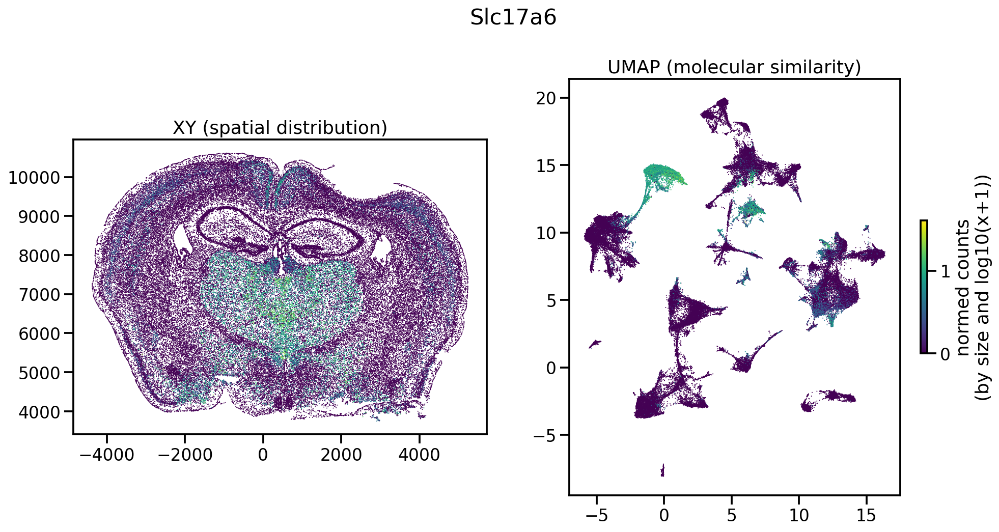

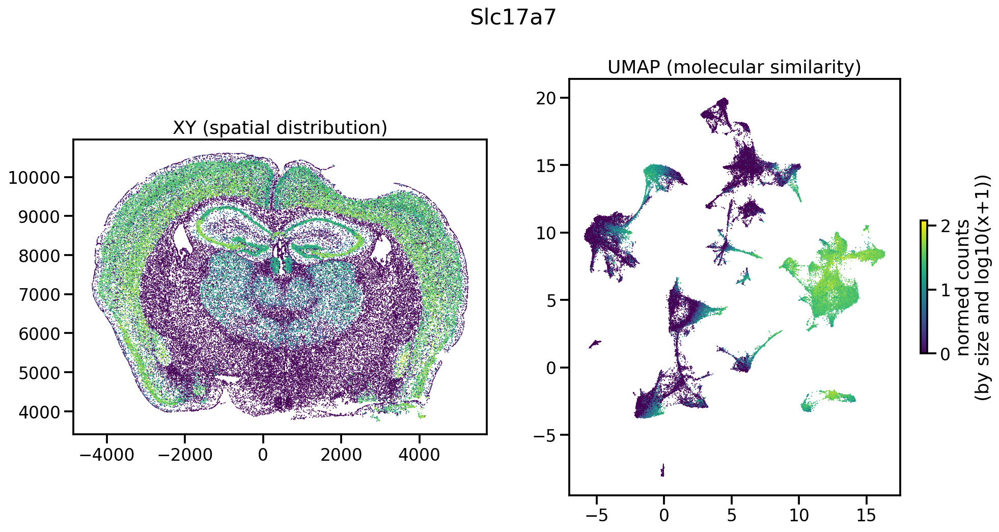

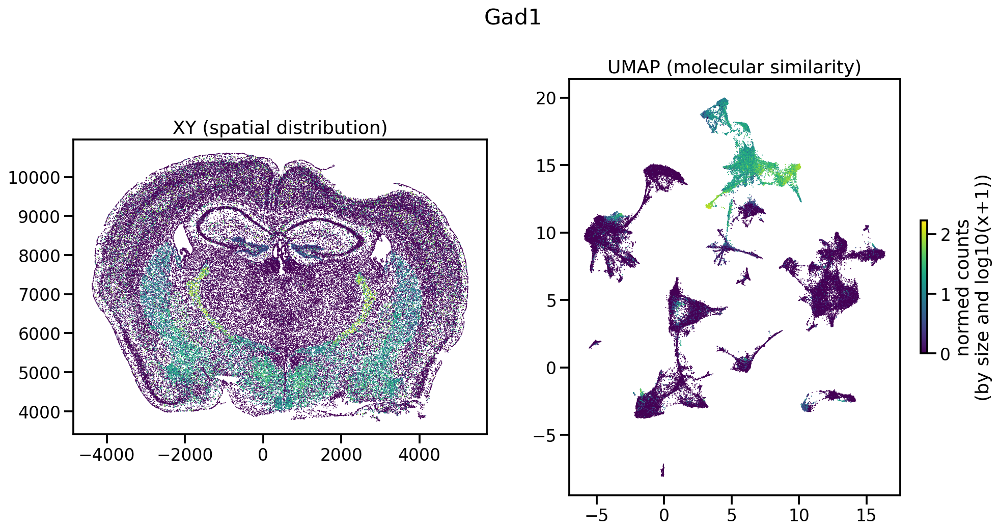

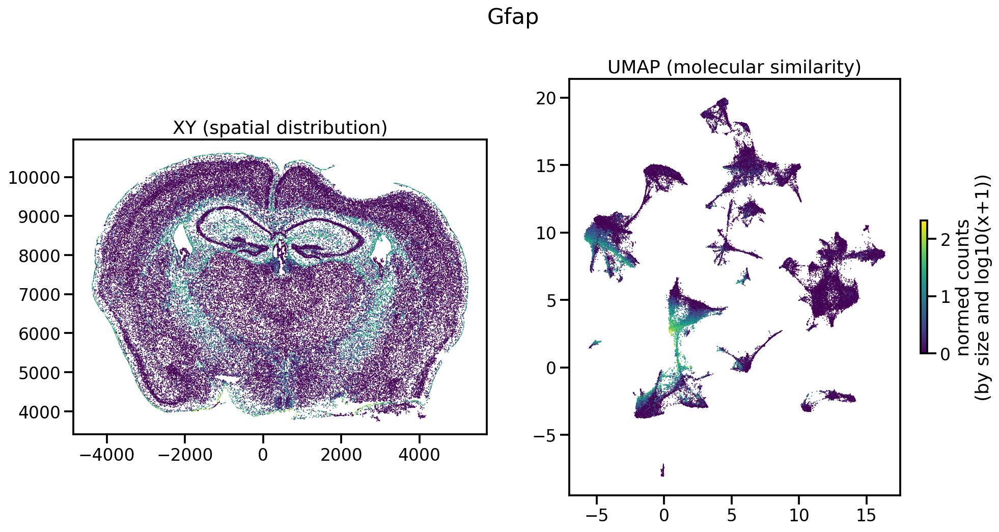

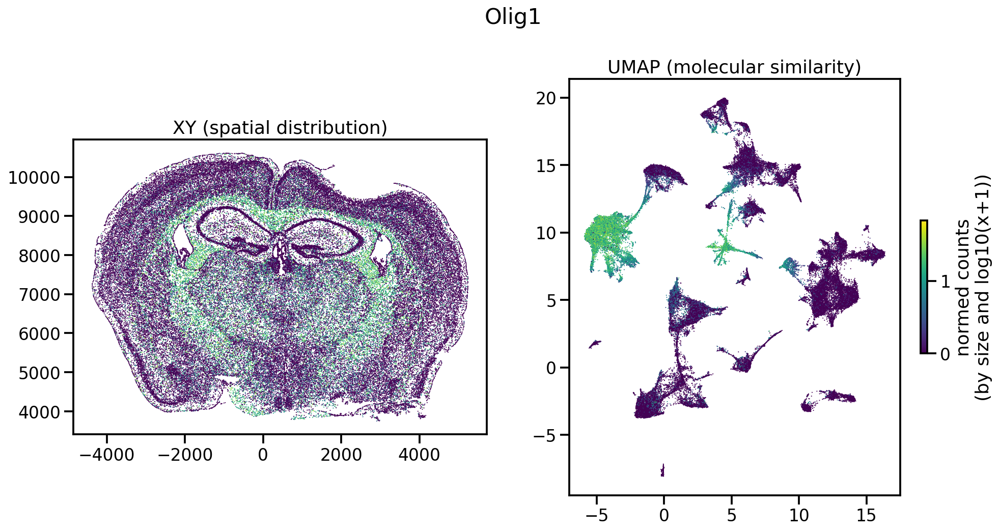

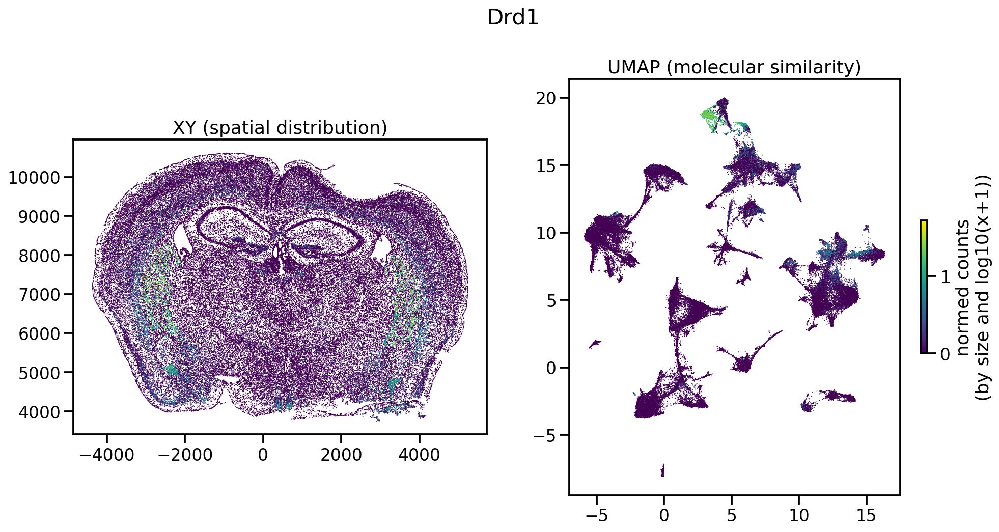

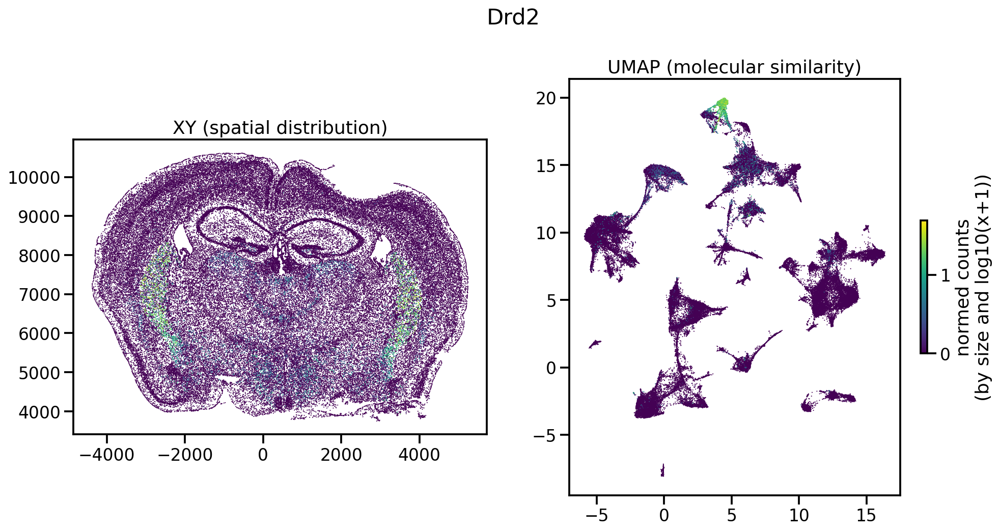

In [ ]:
for gene in [
    'Slc17a6', 'Slc17a7', # exc; different sub populations
    'Gad1',  # inh
    'Gfap', 'Olig1', # spatially co-localized; molecularly distinct
    'Drd1', 'Drd2',  # spatially co-localized; molecularly distinct
    ]:
    st_scatter_xy_umap(xr, yr, uc1, uc2, ftrs_normed, gene)

## Clustering - KMeans
- k specifies how many clusters we aim to identify

In [ ]:
%%time
# clustering (k means clustering)
# takes ~1.5min
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=20)
clsts = kmeans.fit_predict(ftrs_normed.values)
clsts.shape, clsts

CPU times: user 1min 42s, sys: 2.56 s, total: 1min 44s
Wall time: 56.6 s


((84172,), array([15,  7,  2, ...,  7,  7, 10], dtype=int32))

In [ ]:
# visualize clusters
def plot_cluster(clsts, x, y, ux, uy):
  """
  """
  from matplotlib import colors

  unq_clsts, inv = np.unique(clsts, return_inverse=True)
  n_unq = len(unq_clsts)
  # colors = np.array(sns.color_palette('husl', n_unq))
  # c_vec = colors[inv]

  cmap = plt.cm.jet
  norm = colors.BoundaryNorm(np.arange(-0.5, n_unq, 1), cmap.N)

  fig, axs = plt.subplots(1, 2, figsize=(8*2,8))
  
  ax = axs[0]
  g = ax.scatter(x, y, norm=norm, cmap=cmap, c=clsts, s=1, edgecolor='none')
  ax.set_title('XY (spatial distribution)')
  ax.set_aspect('equal')
  
  ax = axs[1]
  ax.scatter(ux, uy, norm=norm, cmap=cmap, c=clsts, s=1, edgecolor='none')
  ax.set_title('UMAP (molecular similarity)')
  ax.set_aspect('equal')

  fig.colorbar(g, ax=ax, label='clusters', ticks=np.arange(n_unq))

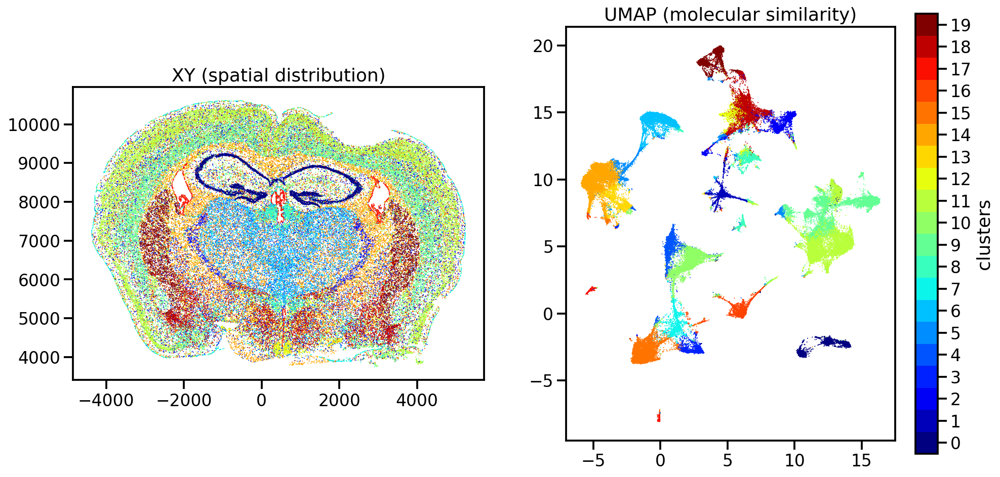

In [ ]:
plot_cluster(clsts, xr, yr, uc1, uc2)

In [ ]:
# # save results
# f = 'colab_umap.txt'
# np.savetxt(f, ucs_normed, fmt='%s')
# f = 'colab_clsts.txt'
# np.savetxt(f, clsts, fmt='%s')

## Bonus point 1: Cluster centroid (pseduo-bulk) profiles
- computationally merging cells from the same cell type (like a in-silico bulk RNA-seq) 

In [ ]:
tmp = ftrs_normed.copy()
tmp['clst'] = clsts
ctrds = tmp.groupby('clst').mean()
ctrds

,Oxgr1,Htr1a,Htr1b,Htr1d,Htr1f,Htr2a,Htr2b,Htr2c,Htr4,Htr5a,...,Pdgfrb,Ptk7,Ret,Ror1,Ror2,Ros1,Ryk,Tek,Tie1,Tyro3
clst,,,,,,,,,,,,,,,,,,,,,
0,0.014886,0.095553,0.095870,0.000873,0.071334,0.038837,0.000288,0.017339,0.222957,0.048829,...,0.011555,0.038194,0.002764,0.116345,0.000184,0.000993,0.372165,0.002553,0.003847,0.251518
1,0.005283,0.010246,0.015469,0.003107,0.010099,0.012782,0.000353,0.026089,0.015562,0.042812,...,0.027144,0.135217,0.023993,0.029860,0.012680,0.000903,0.323943,0.021086,0.016406,0.239698
2,0.004276,0.034178,0.029241,0.006616,0.068359,0.101352,0.000993,0.093021,0.065582,0.098644,...,0.019619,0.042485,0.146494,0.008963,0.008792,0.001186,0.268307,0.008017,0.006101,0.172020
3,0.002477,0.004263,0.006601,0.000545,0.002796,0.008146,0.002314,0.012827,0.006048,0.004008,...,1.259964,0.232605,0.025685,0.207259,0.006106,0.004027,0.582245,0.237212,0.199682,0.067977
4,0.005181,0.007169,0.007243,0.002209,0.003664,0.003962,0.000647,0.015471,0.012660,0.008823,...,0.233229,0.058781,0.019757,0.024494,0.031840,0.001803,0.312831,0.014461,0.013342,0.129802
5,0.004371,0.033263,0.040322,0.007385,0.031308,0.030152,0.000127,0.066786,0.031485,0.044910,...,0.011951,0.028233,0.085943,0.006205,0.007004,0.000933,0.329331,0.010852,0.008712,0.721230
6,0.006286,0.008958,0.018082,0.001771,0.025925,0.000675,0.001286,0.143202,0.013590,0.063236,...,0.021815,0.054963,0.270566,0.013511,0.002321,0.002717,0.226375,0.011915,0.007878,0.139912
7,0.004227,0.002500,0.052222,0.001511,0.001253,0.002604,0.000923,0.010632,0.004254,0.001331,...,0.669626,0.217762,0.032189,0.210041,0.152103,0.000704,0.456681,0.193148,0.168888,0.028129
8,0.010526,0.064430,0.077790,0.020332,0.032221,0.073011,0.000829,0.215299,0.156757,0.096891,...,0.017739,0.080621,0.167854,0.039862,0.055670,0.001294,0.298709,0.008742,0.009422,0.232151


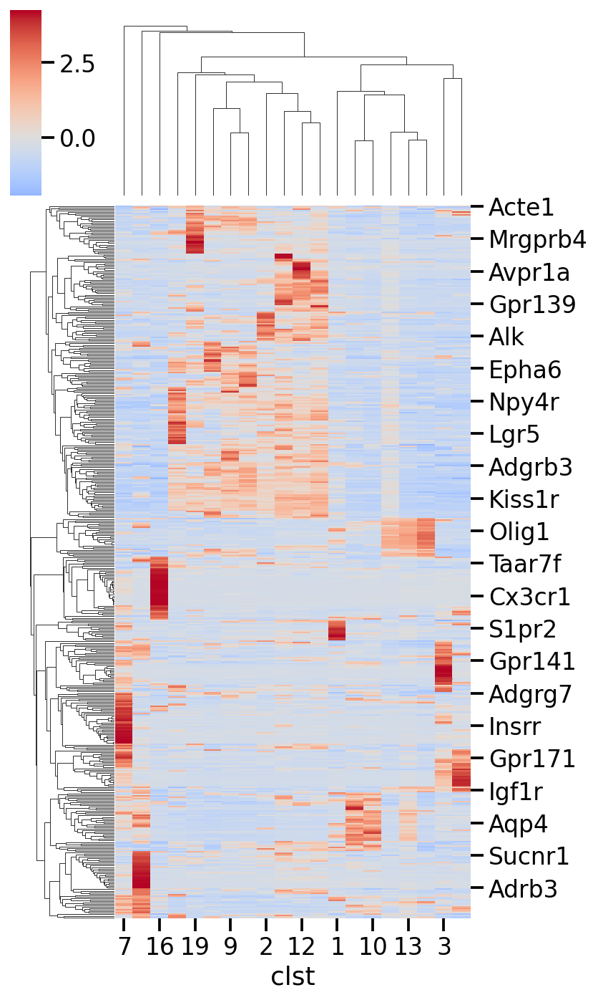

In [ ]:
ctrds_zscore = (ctrds - ctrds.mean())/ctrds.std()
sns.clustermap(ctrds_zscore.T, figsize=(6,10), cmap='coolwarm', center=0)

## Bonus point 2: Enrichment analysis for spatial proximity
- in the style of [Fang et al. 2022 Science](https://www.science.org/doi/10.1126/science.abm1741) (Figure 4)

- enrichment analysis (spatial neighbors of clusters) -- 
 which cell type pairs are enriched in spatial proximity

Steps:
- for each cell, get their k nearest spatial neighbors
- count the results for each cell type pair -- how many connections there are between each pair.
- compare it with what's expected by chance -- homogenous cell types....; are they enriched?

In [ ]:
def get_clst2clst_counts(clsts, knn):
  """Given cluster labels (for each cell) and spatial neighbors (indices; including self), 
  Calculate how many connections (neighbor pairs) each cluster pairs have.
  Return this information as a cluster-by-cluster count matrix
  """
  from scipy import sparse
  knn_clsts = clsts[knn] # cluster label for kNN
  n_unq_clsts = len(np.unique(clsts)) # number of clusters
  
  shape = (n_unq_clsts, n_unq_clsts)
  _self = knn_clsts[:,0]
  _others = knn_clsts[:,1:]
  rows = np.repeat(_self, (k-1)) # repeat 
  cols = np.hstack(_others)
  assert len(rows) == len(cols) 
  data = np.repeat(1, len(rows))
  clst2clst_counts = sparse.coo_matrix((data, (rows, cols)), shape=shape).todense() 
  clst2clst_counts = (clst2clst_counts + clst2clst_counts.T) # each connection counted twice.
  return clst2clst_counts

In [ ]:
# for each cell, get their k nearest spatial neighbors
from sklearn.neighbors import NearestNeighbors
xy = np.vstack([xr, yr]).T

k = 1+6 # 1(self) + 6 nearest neighbors
knn_fit = NearestNeighbors(n_neighbors=k).fit(xy)
knn = knn_fit.kneighbors(xy, return_distance=False)
print(knn.shape)
print(knn)

(84172, 7)
[[    0    14   519 ...     8    16    18]
 [    1    17    13 ...   514     7    12]
 [    2    12     6 ...     7     9     1]
 ...
 [84169 84164 84168 ... 83444 83460 83424]
 [84170 84163 84167 ... 84171 84166 83431]
 [84171 83431 84163 ... 84170 83425 84167]]


In [ ]:
clst2clst_counts = get_clst2clst_counts(clsts, knn)
clst2clst_counts

In [ ]:
# shuffle cells
clsts_shuff = clsts[np.random.choice(len(clsts), size=len(clsts), replace=False)]
clst2clst_counts_shuff = get_clst2clst_counts(clsts_shuff, knn)

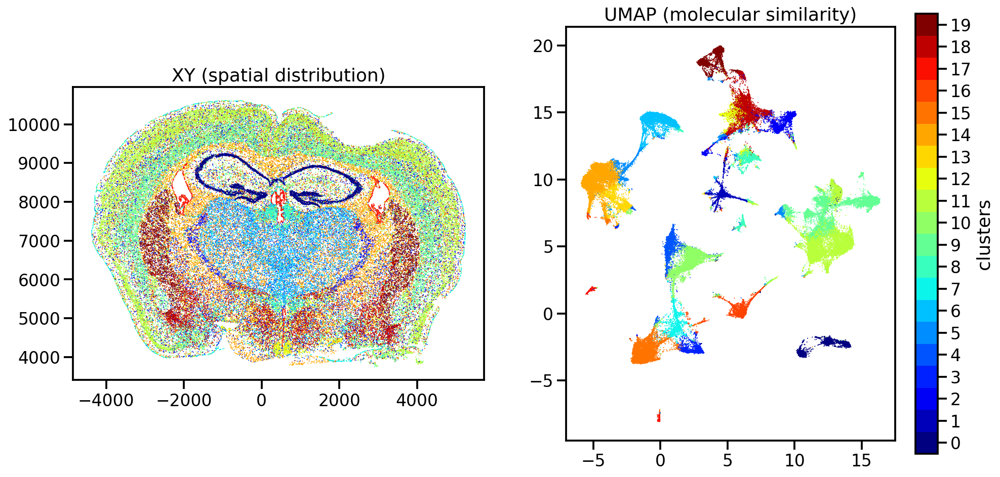

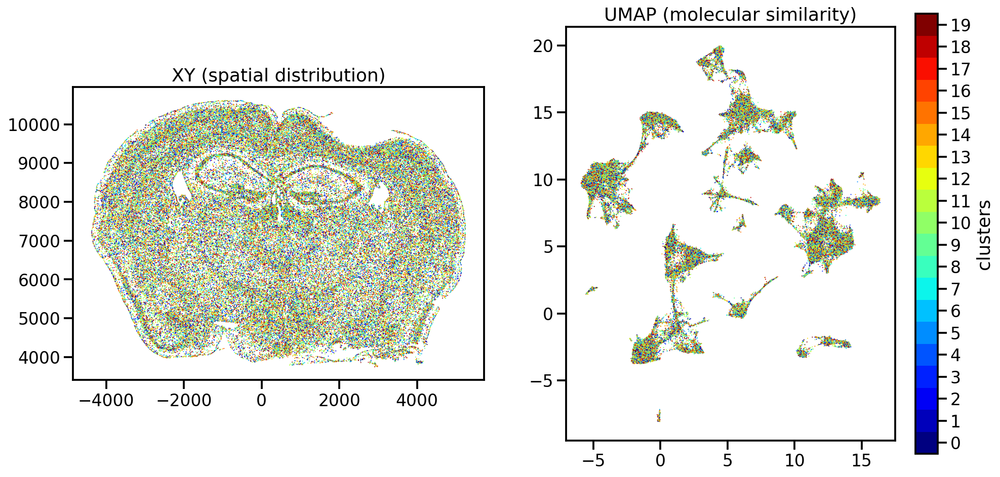

In [ ]:
# visualize the difference between original vs shuffled cell type labels
plot_cluster(clsts, xr, yr, uc1, uc2)
plot_cluster(clsts_shuff, xr, yr, uc1, uc2)

Text(0.5, 1.0, 'observed')

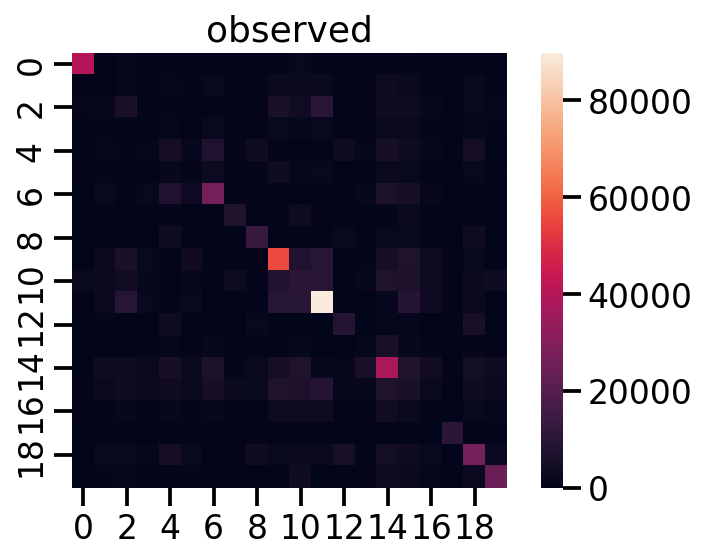

In [ ]:
sns.heatmap(clst2clst_counts)
plt.gca().set_aspect('equal')
plt.title('observed')

Text(0.5, 1.0, 'expected')

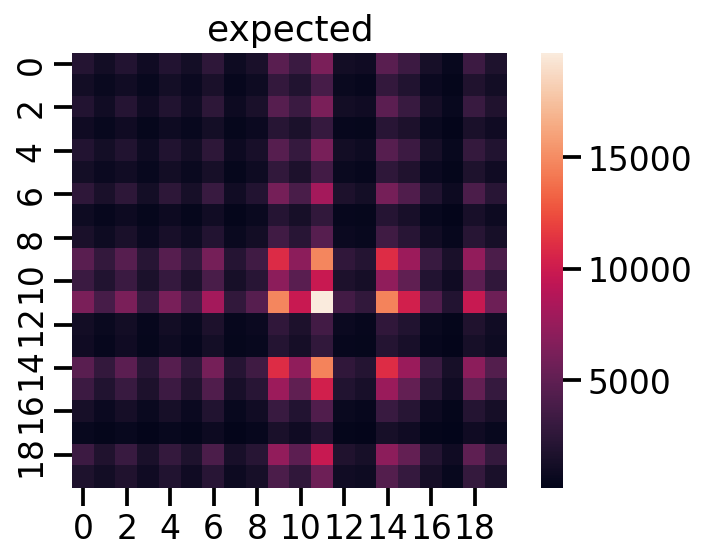

In [ ]:
sns.heatmap(clst2clst_counts_shuff)
plt.gca().set_aspect('equal')
plt.title('expected')

Text(0.5, 1.0, 'enriched: log2(observed/expected)')

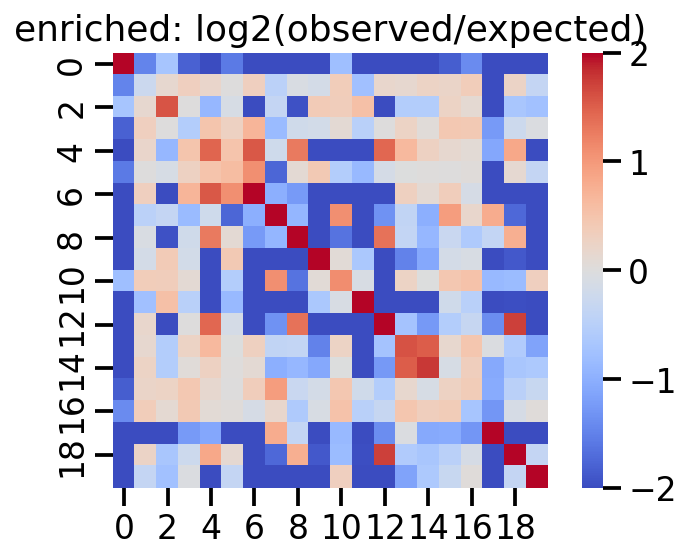

In [ ]:
sns.heatmap(np.log2((1+clst2clst_counts)/(1+clst2clst_counts_shuff)), # 1 is pseudo count to avoid 0 in log. 
            cmap='coolwarm',
            vmax=2,vmin=-2,
            )
plt.gca().set_aspect('equal')
plt.title('enriched: log2(observed/expected)')

## Bonus follow-up questions
- How do we make sure the expected pattern is stable (not a fluke of 1 particular random shuffle)? 
- How do we evaluate the statistical significance of the enrichment?

Answer:
- We can repeat random shuffling many many times (100, 1000, 10,000) and recount number of spatial neighbors between cell-type pairs; this will stablize the expected pattern and allow us to estimate emprical p-values.